# Self-Driving Car Engineer Nanodegree 
## Project IV : Advanced Lane Lines


[![Udacity - Self-Driving Car NanoDegree](https://s3.amazonaws.com/udacity-sdc/github/shield-carnd.svg)](http://www.udacity.com/drive)

### Overview

In this project, your goal is to write a software pipeline to identify the lane boundaries in a video, but the main output or product we want you to create is a detailed writeup of the project. Check out the writeup template for this project and use it as a starting point for creating your own writeup.


### The Project
The goals / steps of this project are the following:

- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

- Apply a distortion correction to raw images.

- Use color transforms, gradients, etc., to create a thresholded binary image.

- Apply a perspective transform to rectify binary image ("birds-eye view").

- Detect lane pixels and fit to find the lane boundary.

- Determine the curvature of the lane and vehicle position with respect to center.

- Warp the detected lane boundaries back onto the original image.

- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

The images for camera calibration are stored in the folder called camera_cal. The images in test_images are for testing your pipeline on single frames. To help the reviewer examine your work, please save examples of the output from each stage of your pipeline in the folder called ouput_images, and include a description in your writeup for the project of what each image shows. The video called project_video.mp4 is the video your pipeline should work well on.

The challenge_video.mp4 video is an extra (and optional) challenge for you if you want to test your pipeline under somewhat trickier conditions. The harder_challenge.mp4 video is another optional challenge and is brutal!

If you're feeling ambitious (again, totally optional though), don't stop there! We encourage you to go out and take video of your own, calibrate your camera and show us how you would implement this project from scratch!

In [14]:
%matplotlib inline

from utilities import config,  camera_calibration , utility,  line_detection, transform, lane_detection
import cv2
import matplotlib.pyplot as plt
import numpy as np

from moviepy.editor import VideoFileClip
from IPython.display import HTML, YouTubeVideo
import scipy.misc

#np.random.seed(44)

In [15]:
## helper to display image grid
def grid_plot(image_cols):
    ncols = len(image_cols)
    nrows = len(image_cols[0][1])
    fig, axes = plt.subplots(nrows, ncols, figsize = (8*ncols, 4*nrows))
    fig.tight_layout()
    fig.subplots_adjust(wspace = 0.1, hspace=0.1, )

    for r, ax in enumerate(axes):
        for c, (colname, imgs) in enumerate(image_cols):
            img = imgs[r]
            cmap = plt.cm.gray if img.ndim < 3 else None
            ax[c].imshow(img, cmap=cmap)
            ax[c].set_axis_off()
            ax[c].set_title(colname)

## 1. Camera Calibration

Camera calibration estimates the camera parameters (camera matrix and distortion coefficients) using the calibration chessboard images to correct for lens distortion, measure the size of an object in world units, or determine the location of the camera in the scene and undistort the test calibration images


Undistortion function is implemented in `utilities/camera_calibration.py`

The results of finding corners and undistortion of chessboard images are shown below.

In [ ]:
cc = camera_calibration.CameraCalibration()
cc.display_corners(config.camera_calibration_images)

In [ ]:
chessboard_imgs = [cv2.cvtColor(cv2.imread(image_file), cv2.COLOR_BGR2RGB) for image_file in config.camera_calibration_images]

undistort = camera_calibration.build_undistort_image()
undistort_chessboard = list(map(undistort, chessboard_imgs))


unchessboard = undistort_chessboard[0]
grid_plot( [("original", chessboard_imgs), 
           ("undistorted", undistort_chessboard)])

## 2. Pipeline (single images)

In [21]:
## load the test images
test_imgs = [cv2.cvtColor(cv2.imread(image_file), cv2.COLOR_BGR2RGB) for image_file in config.test_images]

### 2.1 Distortion-corrected image

To demonstrate this step, `build_undistort_image()` function in `utilities/camera_calibration.py` apply the camera matrix and distortion coefficients estimated from chessboard images to correct the distorted images in test_images folder.

The results of distortion correction are shown below. 



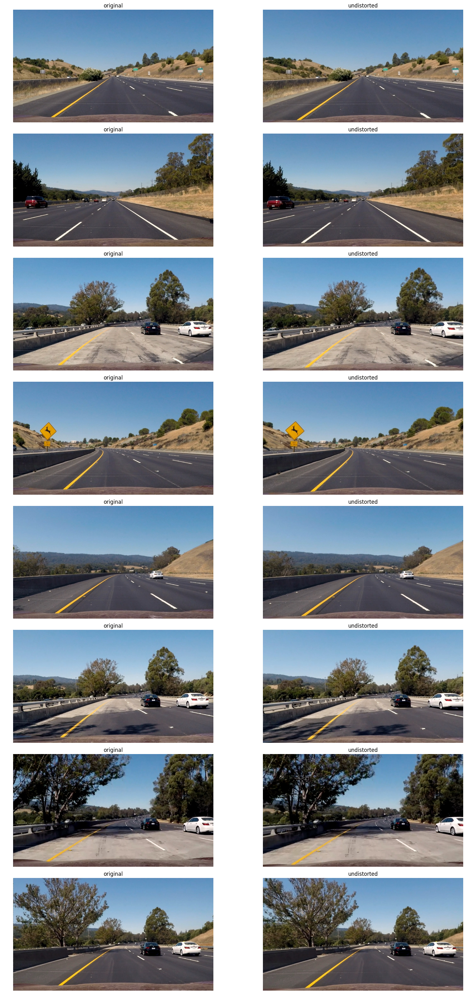

In [22]:
undistort = camera_calibration.build_undistort_image()

undistorted_imgs = list(map(undistort, test_imgs))
grid_plot( [("original", test_imgs), 
           ("undistorted", undistorted_imgs)])

### 2.2 Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image

There are two steps implemented for line detection:

- Detection of lines from undistorted images by a combination:
   - sobel of x on a gray image from HLS channel - detecting lines with horizontal gradients
   
   - two sobel of directions, $arctan({\frac{sobely}{sobelx}})$, from hls channel - as left and right lines within a certain angel ranges

   - combination of the above three - lines_with_gradx AND (left_line OR right_line).

the L and S channel of HLS images are specially good at detecting bright lines in spite of color changes and shadows.
This is implemented in sdclane.line_detection.LineDetector.detect()

- A cropping within a trapezoidal ROI at the bottom.

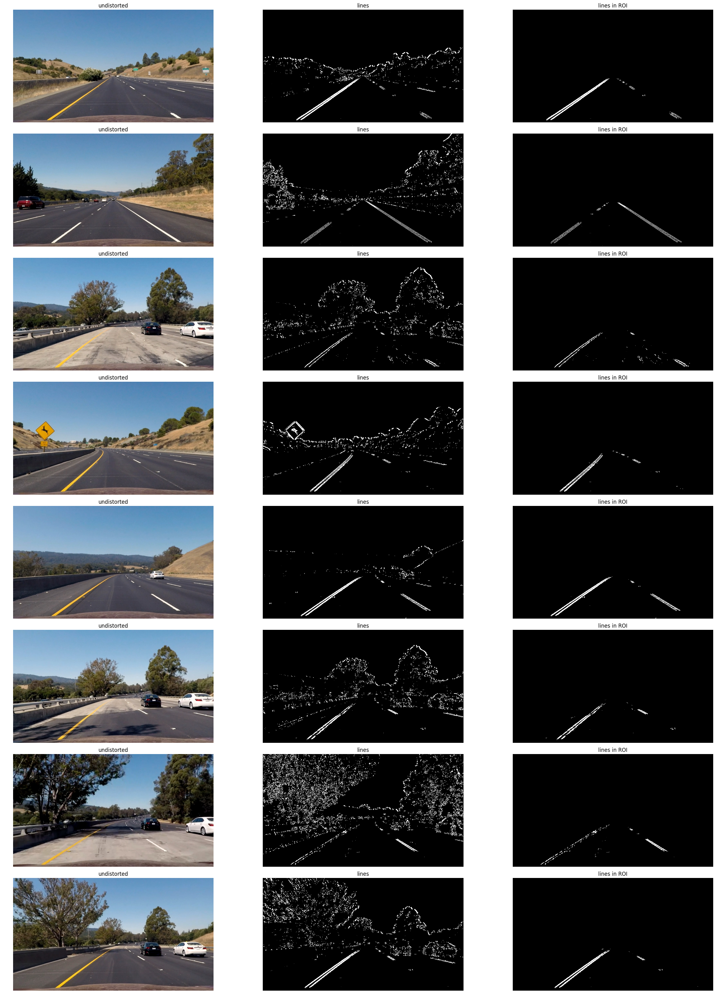

In [23]:
detect_line = line_detection.LineDetector().detect
roi_crop = transform.build_trapezoidal_bottom_roi_crop_function()

line_imgs = list(map(detect_line, undistorted_imgs))
roi_line_imgs = list(map(roi_crop, line_imgs))

grid_plot([("undistorted", undistorted_imgs),
          ("lines", line_imgs),
          ("lines in ROI", roi_line_imgs)])

### 2.3 Perspective transform

The perspective transform is implemented in `transform.PerspectiveTransformer` class, in several steps:

- pick a training image where two lanes are roughly linear and parallel to each other. I picked test_imgs[3] as the reference by visual checking. This is customizable in sdclane.config package.

- detect the two lanes as the two legs of a trapzoid in the original space, and map them to a rectangle in the warped space.

k-means is used to separate the pixels into left and right lanes, and use ransac model to estimate a robust model of lines for each.

- the choice of the target rectangle is relatively arbitrary, as long as the estimate of meter-per-pixel later on is consistent.

- estimate the transform matrix and its inverse by cv2.getPerspectiveTransform on the trapzoid and rectangle.

- estimate the meter-per-pixel x_mpp and y_mpp so later you can use them to estimate other parameters such as curvatures and center offsets.

- estimate of x_mpp is relatively straightforward. We assume the width of the lane is always 3 meters and x_mpp is the ratio of lane width w.r.t the width of the target rectangle in warped space.

I estimated y_mpp in a slightly different way from in the clas - I chose the longest segment of the dotted lane and assumed it to be 3 meters in reality (as suggested in the class). This gives different curvature and offset estimate later on, but I am not really sure which is more (or less) accurate because the method used in the class is also quite ad hoc.

- after esimating the transform matrix, you can transform any new image (original RGB image or simply its binary line image) to a bird-eye view. These are implemented as PerspectiveTransformer.transform() and PerspectiveTransformer.binary_transform().

In [ ]:
transformer = transform.build_default_warp_transformer()

warped_imgs = list(map(transformer.transform, test_imgs))
grid_plot([("undistorted", undistorted_imgs),
          ("bird-eye view", warped_imgs)])

### 2.4  Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?



The same techniques can be used to detect the lane pixels in the warped images. However, I choose to directly transform the line pixels from original image space to the bird-eye view space, by using PerspectiveTransformer.binary_transform(). This is based on the observations that (1) the lane detection in original images are already visually good (2) in the bird-eye view the lanes are still clear, and (3) it makes the code simpler.
The results of the lane pixels in the bird-eye view are shown below. We can see there are some noises in the final lane images, which need to be removed before parameter estimation.

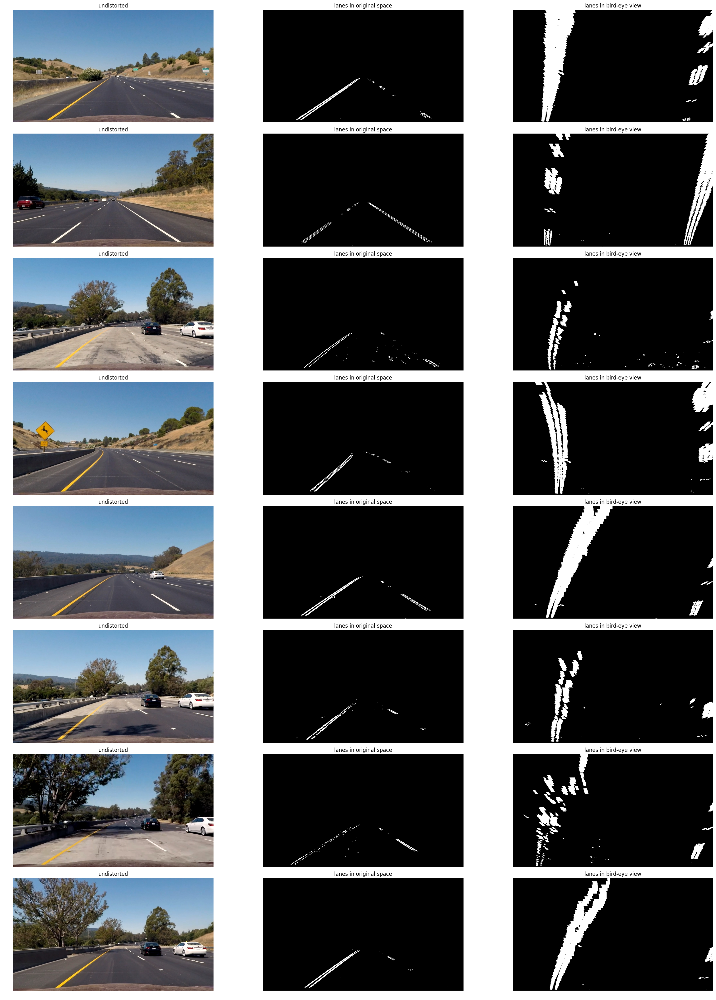

In [30]:
lane_imgs = list(map(transformer.binary_transform, roi_line_imgs))

grid_plot([
    ("undistorted", undistorted_imgs),
    ("lanes in original space", roi_line_imgs),
    ("lanes in bird-eye view", lane_imgs)
])

### 2.5 Lane parameter estimation

we have the lane pixels in bird-eye view and meter-per-pixel for both x and y, estimating the curvature and the center offset is straightforward. The whole process is implemented in `lane_detection.LaneDetector.detect_image()`:

- noise processing - remove small holes and objects in the lane image by morphology operations. This is implemented in LaneDetector.get_lane_pixels().

- divide the pixels into left and right lanes by sliding a window vertically from top down, and separating left and right as pixel groups that are apart from each other. This is implemented in LaneDetector.get_lane_pixels().

- After getting pixels for each lane, a 2nd order polynomial is fit for each lane, based on which the radius of curvature and center offset are caculated in LaneDetector.estimate_lane_params(). To calculate these parameter values in reality, the previously estimated meter-per-pixel x_mpp and y_mpp from transform are used.

- The parameters for two lanes are used to validate the performance of the lane detection, this is important when later it is used to detect videos, where either fast-tracking or search-from-beginning can be used based on whether the detection result is good enough.

- The estimated 2nd polynoimal approximation of lanes, together with their middle curves, are overlayed onto the image for furthure visual check.

In [ ]:
lane_imgs = list(map(transformer.binary_transform, roi_line_imgs))
histogram = [np.sum(i[i.shape[0]/2:,:], axis=0) for i in lane_imgs]

for i in range(len(lane_imgs)):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(lane_imgs[i], cmap='gray')
    ax1.set_title('lanes in bird-eye view', fontsize=50)
    ax2.plot(histogram[i])
    ax2.set_title('histogram', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 2.6 Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

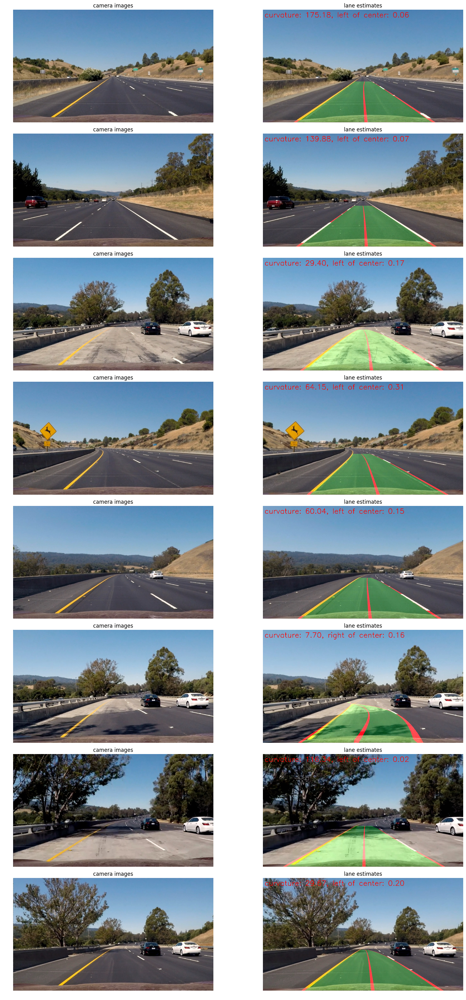

In [27]:
# build lane detector
lane_detector = lane_detection.LaneDetector()

lane_estimates = [lane_detector.detect_image(img)[1] for img in test_imgs]

grid_plot([
    ("camera images", test_imgs),
    ("lane estimates", lane_estimates)
])

### Save images

In [ ]:
def save_image(img, img_name):
    scipy.misc.imsave(config.output_images_dir + img_name, img)
    

for indx,img in enumerate(undistorted_imgs):
    img_name = 'undistorted_' + str(indx)+ '.jpg'
    save_image(img, img_name)
    
for indx,img in enumerate(warped_imgs):
    img_name = 'warped_image_' + str(indx)+ '.jpg'
    save_image(img, img_name) 
    
for indx,img in enumerate(line_imgs):
    img_name = 'detected_line_image_' + str(indx)+ '.jpg'
    save_image(img, img_name)     
    
for indx,img in enumerate(lane_estimates):
    img_name = 'estimated_lane_image_' + str(indx)+ '.jpg'
    save_image(img, img_name)     
    

## 3. Pipeline for video

### 3.1 Lane detection

The lane detection pipeline for videos are implemented in `lane_detection.LaneDetector` class, under the LaneDetector.detect_video() method. The result will be shown below.

### 3.2 Lane search for first frame

LaneDetector.detect_video() method is implemented in a way that

- it always detects lanes by performing a full search (as in test_image() method) if there is no estimates from the previous frame available.

- if an estimate from previous frame is available, it will try to use a faster search method by looking in a small neighborhood of the last detection, assuming the positions of new lanes will not be too different from the last ones. This is implemented in LaneDetector.process_frame() method.

- however, if the detection result from step 2 is not good enough (based on whether the two lanes are roughly parallel in their linear parts), it will go back to using a full search for the next frame.

- if both fast search and full search fail for some frames, it simply returns as no lanes for the current frame.

### 3.3 Tracking of different frames

In details, the "faster search" based on tracking of last frame works as follows,

- generate sample points from lane models of last detection

- find lane pixels for the current frame within the neighbors of the generated samples, as a sliding window.

- estimate the current lane parameters based on these detected lane pixels.

This is implemented in LaneDetector.process_frame(). There are many heuristic-based parameters that hard-code the detection algorithm, such as sliding window size and etc. I am not confident at all whether it will work on new scenarios.
The result on project_video.mp4 is shown below. The algorithm works partially on the two challenge vidoes, when certain assumptions made in the code are met in the videos. However I didn't go further to modify the code to work on these challenges. As mentioned above, I am not really convinced by the material in this project, so even it succeeds on the challenge videos, I have no confidence at all that it will work on new scenarios.

In [13]:
clip_output_file = config.output_images_dir + 'project_video_output.mp4'
clip = VideoFileClip("project_video.mp4")
clip_output = lane_detector.detect_video(clip)
%time clip_output.write_videofile(clip_output_file, audio=False)

[MoviePy] >>>> Building video output_images/project_video_output.mp4
[MoviePy] Writing video output_images/project_video_output.mp4


100%|█████████▉| 1260/1261 [06:49<00:00,  5.79it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project_video_output.mp4 

CPU times: user 6min 59s, sys: 1min 21s, total: 8min 21s
Wall time: 6min 50s


Here's a [link to my video result](https://raw.githubusercontent.com/dvu4/CarND-Advanced-Lane-Lines/master/output_images/challenge_video_output.mp4)

In [ ]:
YouTubeVideo('kWFTLy5BRhE')

In [12]:
clip_output_file = config.output_images_dir + 'challenge_video_output.mp4'
clip = VideoFileClip("challenge_video.mp4")
clip_output = lane_detector.detect_video(clip)
%time clip_output.write_videofile(clip_output_file, audio=False)

[MoviePy] >>>> Building video output_images/challenge_video_output.mp4
[MoviePy] Writing video output_images/challenge_video_output.mp4


100%|██████████| 485/485 [02:03<00:00,  5.57it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/challenge_video_output.mp4 

CPU times: user 2min 11s, sys: 26 s, total: 2min 37s
Wall time: 2min 4s


In [ ]:
YouTubeVideo('kvDX8XTdlaQ')

In [14]:
clip_output_file = config.output_images_dir + 'harder_challenge_video_output.mp4'
clip = VideoFileClip("harder_challenge_video.mp4")
clip_output = lane_detector.detect_video(clip)
%time clip_output.write_videofile(clip_output_file, audio=False)

[MoviePy] >>>> Building video output_images/harder_challenge_video_output.mp4
[MoviePy] Writing video output_images/harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [05:29<00:00,  4.95it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/harder_challenge_video_output.mp4 

CPU times: user 5min 44s, sys: 1min 8s, total: 6min 52s
Wall time: 5min 30s


In [ ]:
YouTubeVideo('kvDX8XTdlaQ')

## 4. Discussion

### 4.1 Problems/issues

This project is very challenging since I am new to computer vision. I think there are some difficulties I faced during this project:

- How to automatically detect the src and dst points for perspective transform ?

- How to effectively find the best combination of binary image and its best threshold ?

- How to figure out the right size of sliding window to detect lane lines?

- Can we apply deep learning for lane lines detection ?

- Is there any technique to try out ways of smoothing method across previous frames other than simple mean? In this project, the detection of lanes are rather smooth across successive frames because a simple smoothing method has been implemented to take the moving averages of estimations. However the middle curve is still a little bumpy, it failed to track the lane.
